Análisis exploratorio de datos

In [3]:
import sys
print(sys.executable)

/Users/cbarril/dev/posgrado/vpc2_19co2025/vpc2/bin/python


In [8]:
import src.utils as utils

utils.download_plantvillage_dataset()

Dataset URL: https://www.kaggle.com/datasets/abdallahalidev/plantvillage-dataset


KeyboardInterrupt: 

Tenemos un dataset de imágenes de plantas que pueden estar sanas o enfermas. El dataset contiene imágenes de 14 especies de plantas, algunas con ciertas enfermedades, y otras con ejemplos de la planta únicamente sanas. Las imágenes están organizadas en carpetas por especie y enfermedad.

Traducción de las especies:

* Apple: Manzana
* Blueberry: Arándano
* Cherry: Cereza
* Corn: Maíz
* Grape: Uva
* Peach: Durazno
* Pepper: Pimiento
* Potato: Papa
* Raspberry: Frambuesa
* Soybean: Soja
* Strawberry: Fresa
* Tomato: Tomate

Traducción de las enfermedades:

* scab: sarna
* black rot: podredumbre negra
* cedar apple rust: roya del manzano y cedro (hinchazón color rojizo a naranja producida por un hongo)
* powdery mildew: oídio (cenicilla o polvillo blanco - enfermedad fúngica)
* cercospora leaf spot / gray leaf spot: mancha foliar por cercospora / mancha foliar gris
* common rust: roya común
* northern leaf blight: tizón foliar del norte
* esca (black measles): esca (manchas negras)
* leaf blight (Isariopsis leaf spot): tizón de la hoja (mancha foliar por Isariopsis)
* Haunglongbing (HLB) / citrus greening: Huanglongbing (HLB) / enverdecimiento de los cítricos
* bacterial spot: mancha bacteriana
* early blight: tizón temprano
* late blight: tizón tardío
* leaf scorch: quemadura de la hoja
* bacterial spot: mancha bacteriana
* leaf mold: moho de la hoja
* septoria leaf spot: mancha foliar por septoria
* spider mites two-spotted spider mite: ácaros araña de dos manchas
* target spot: mancha diana
* mosaic virus: virus del mosaico
* yellow leaf curl virus: virus del rizado amarillo de la hoja

Clases disponibles por especie:

* Apple:
    * healthy
    * scab
    * black rot
    * cedar apple rust
* Blueberry:
    * healthy
* Cherry:
    * healthy
    * powdery mildew
* Corn:
    * healthy
    * cercospora leaf spot / gray leaf spot
    * common rust
    * northern leaf blight
* Grape:
    * healthy
    * black rot
    * esca (black measles)
    * leaf blight (Isariopsis leaf spot)
* Orange:
    * Haunglongbing (HLB) / citrus greening
* Peach:
    * healthy
    * bacterial spot
* Pepper:
    * healthy
    * bacterial spot
* Potato:
    * healthy
    * early blight
    * late blight
* Raspberry:
    * healthy
* Soybean:
    * healthy
* Squash:
    * healthy
* Strawberry:
    * healthy
    * leaf scorch
* Tomato:
    * healthy
    * bacterial spot
    * early blight
    * late blight
    * leaf mold
    * septoria leaf spot
    * spider mites two-spotted spider mite
    * target spot
    * mosaic virus
    * yellow leaf curl virus

Plantas disponibles por clase:

* healthy: Apple, Blueberry, Cherry, Corn, Grape, Peach, Pepper, Potato, Raspberry, Soybean, Strawberry, Tomato
* scab: Apple
* black rot: Apple, Grape
* cedar apple rust: Apple
* powdery mildew: Cherry
* cercospora leaf spot / gray leaf spot: Corn
* common rust: Corn
* northern leaf blight: Corn
* esca (black measles): Grape
* leaf blight (Isariopsis leaf spot): Grape
* Haunglongbing (HLB) / citrus greening: Orange
* bacterial spot: Peach, Pepper, Tomato
* early blight: Potato, Tomato
* late blight: Potato, Tomato
* leaf scorch: Strawberry
* bacterial spot: Tomato
* leaf mold: Tomato
* septoria leaf spot: Tomato
* spider mites two-spotted spider mite: Tomato
* target spot: Tomato
* mosaic virus: Tomato
* yellow leaf curl virus: Tomato

In [ ]:
utils.summarize_plantvillage_dataset()

In [16]:
import pandas as pd
import os

base_dir = '../data/plantvillage/plantvillage dataset'
subfolders = ['color', 'grayscale', 'segmented']
data = []

for sub in subfolders:
    sub_path = os.path.join(base_dir, sub)
    if not os.path.exists(sub_path):
        continue
    for folder in os.listdir(sub_path):
        folder_path = os.path.join(sub_path, folder)
        if not os.path.isdir(folder_path):
            continue
        if '___' in folder:
            species, disease = folder.split('___', 1)
        else:
            species, disease = folder, ''
        img_count = len([
            f for f in os.listdir(folder_path)
            if os.path.isfile(os.path.join(folder_path, f))
        ])
        print(sub, " ", species, " ", disease, " ", img_count)
        data.append({
            'Species': species,
            'Disease': disease,
            'Type': sub,
            'ImageCount': img_count
        })

df = pd.DataFrame(data)

color   Strawberry   healthy   456
color   Grape   Black_rot   1180
color   Potato   Early_blight   1000
color   Blueberry   healthy   1502
color   Corn_(maize)   healthy   1162
color   Tomato   Target_Spot   1404
color   Peach   healthy   360
color   Potato   Late_blight   1000
color   Tomato   Late_blight   1909
color   Tomato   Tomato_mosaic_virus   373
color   Pepper,_bell   healthy   1478
color   Orange   Haunglongbing_(Citrus_greening)   5507
color   Tomato   Leaf_Mold   952
color   Grape   Leaf_blight_(Isariopsis_Leaf_Spot)   1076
color   Cherry_(including_sour)   Powdery_mildew   1052
color   Apple   Cedar_apple_rust   275
color   Tomato   Bacterial_spot   2127
color   Grape   healthy   423
color   Tomato   Early_blight   1000
color   Corn_(maize)   Common_rust_   1192
color   Grape   Esca_(Black_Measles)   1383
color   Raspberry   healthy   371
color   Tomato   healthy   1591
color   Cherry_(including_sour)   healthy   854
color   Tomato   Tomato_Yellow_Leaf_Curl_Virus   5357


In [20]:
df.sort_values(['Species', 'Disease', 'Type'], inplace=True)
df

,Species,Disease,Type,ImageCount
25,Apple,Apple_scab,color,630
63,Apple,Apple_scab,grayscale,630
101,Apple,Apple_scab,segmented,630
33,Apple,Black_rot,color,621
71,Apple,Black_rot,grayscale,621
...,...,...,...,...
47,Tomato,Tomato_mosaic_virus,grayscale,373
85,Tomato,Tomato_mosaic_virus,segmented,373
22,Tomato,healthy,color,1591
60,Tomato,healthy,grayscale,1591


In [22]:
import numpy as np

pivot = df.pivot_table(index=['Species', 'Disease'], columns='Type', values='ImageCount', fill_value=0)
pivot['AllEqual'] = pivot.apply(lambda row: np.all(row == row.iloc[0]), axis=1)
print(pivot)

Type                                                           color  \
Species                 Disease                                        
Apple                   Apple_scab                             630.0   
                        Black_rot                              621.0   
                        Cedar_apple_rust                       275.0   
                        healthy                               1645.0   
Blueberry               healthy                               1502.0   
Cherry_(including_sour) Powdery_mildew                        1052.0   
                        healthy                                854.0   
Corn_(maize)            Cercospora_leaf_spot Gray_leaf_spot    513.0   
                        Common_rust_                          1192.0   
                        Northern_Leaf_Blight                   985.0   
                        healthy                               1162.0   
Grape                   Black_rot                             11

In [28]:
color_count = df[df['Type'] == 'color']['ImageCount'].sum()
print("Number of rows with type color:", color_count)

color_count = df[df['Type'] == 'grayscale']['ImageCount'].sum()
print("Number of rows with type grayscale:", color_count)

color_count = df[df['Type'] == 'segmented']['ImageCount'].sum()
print("Number of rows with type segmented:", color_count)

Number of rows with type color: 54305
Number of rows with type grayscale: 54305
Number of rows with type segmented: 54306


In [29]:
df[df['Species'] == 'Grape']

,Species,Disease,Type,ImageCount
1,Grape,Black_rot,color,1180
39,Grape,Black_rot,grayscale,1180
77,Grape,Black_rot,segmented,1180
20,Grape,Esca_(Black_Measles),color,1383
58,Grape,Esca_(Black_Measles),grayscale,1383
96,Grape,Esca_(Black_Measles),segmented,1384
13,Grape,Leaf_blight_(Isariopsis_Leaf_Spot),color,1076
51,Grape,Leaf_blight_(Isariopsis_Leaf_Spot),grayscale,1076
89,Grape,Leaf_blight_(Isariopsis_Leaf_Spot),segmented,1076
17,Grape,healthy,color,423


In [31]:
import os

base_dir = '../data/plantvillage/plantvillage dataset'
species_disease = 'Grape___Esca_(Black_Measles)'

color_path = os.path.join(base_dir, 'color', species_disease)
segmented_path = os.path.join(base_dir, 'segmented', species_disease)

def get_uuids(file_list):
    return set(f.split('_')[0] for f in file_list)

color_files = set(os.listdir(color_path)) if os.path.exists(color_path) else set()
segmented_files = set(os.listdir(segmented_path)) if os.path.exists(segmented_path) else set()

color_uuids = get_uuids(color_files)
segmented_uuids = get_uuids(segmented_files)

only_in_segmented = segmented_uuids - color_uuids
print("UUIDs in segmented but not in color:", only_in_segmented)

UUIDs in segmented but not in color: {'7e1fd9b9-1fd9-4f98-93f5-8cf9ebc60dd9'}


Total files found: 162916


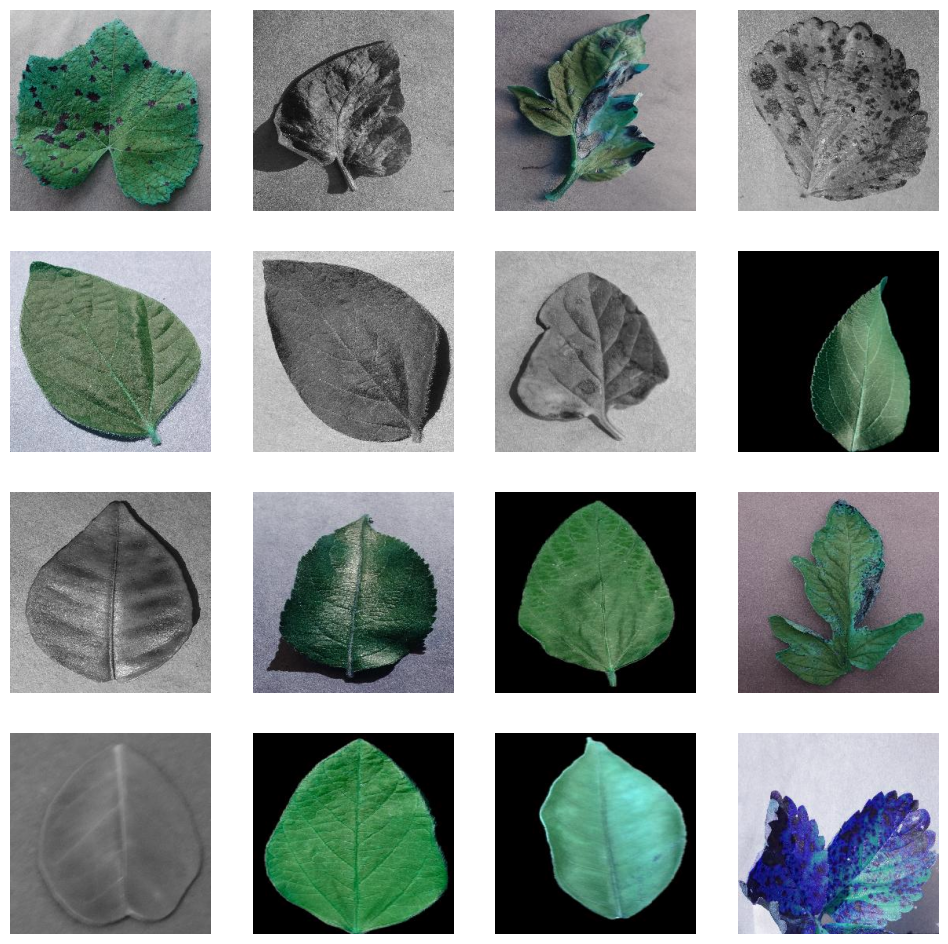

In [6]:
import os
import random
import numpy as np
from PIL import Image
import supervision as sv

base_dir = '../data/plantvillage/plantvillage dataset'
types = ['color', 'grayscale', 'segmented']
all_files = []

# Collect all files as type/relative_path
for t in types:
    type_dir = os.path.join(base_dir, t)
    for root, dirs, files in os.walk(type_dir):
        for file in files:
            rel_path = os.path.relpath(os.path.join(root, file), type_dir)
            all_files.append(f"{t}/{rel_path}")

print(f"Total files found: {len(all_files)}")

# Show 16 random images in a 4x4 grid
sample_files = random.sample(all_files, 16)
images = [np.array(Image.open(os.path.join(base_dir, f))) for f in sample_files]
sv.plot_images_grid(images, grid_size=(4, 4))

Total files found: 162916


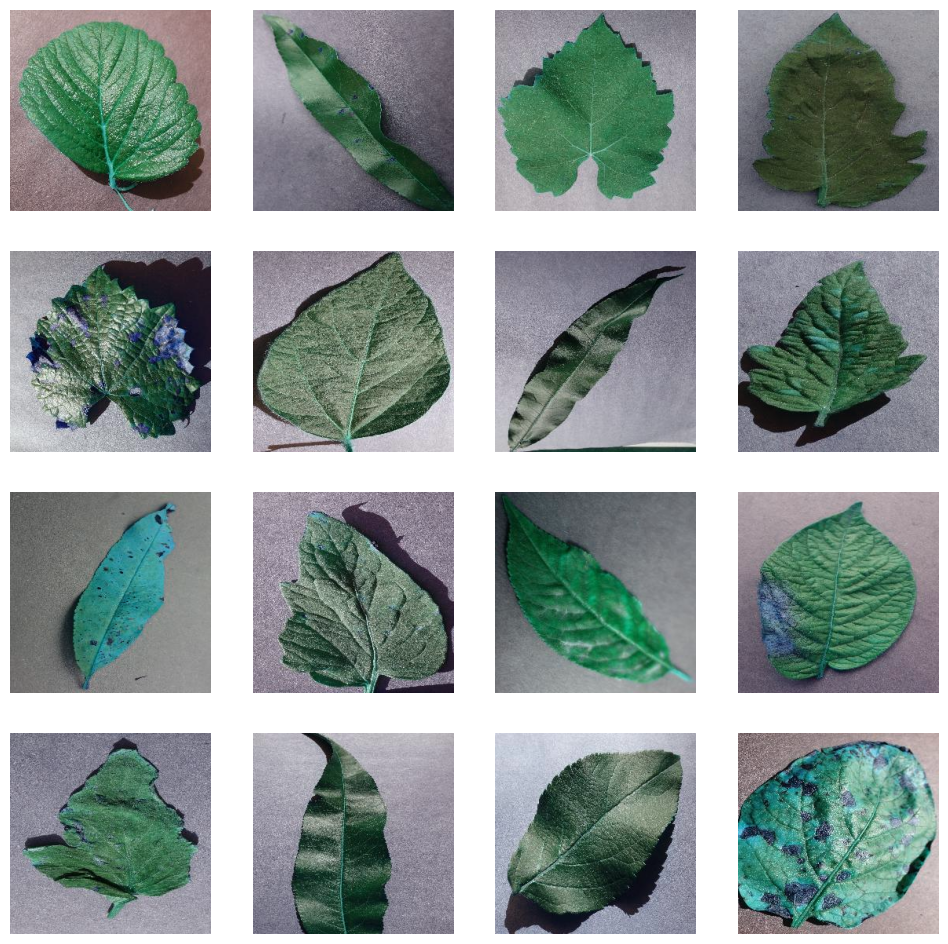

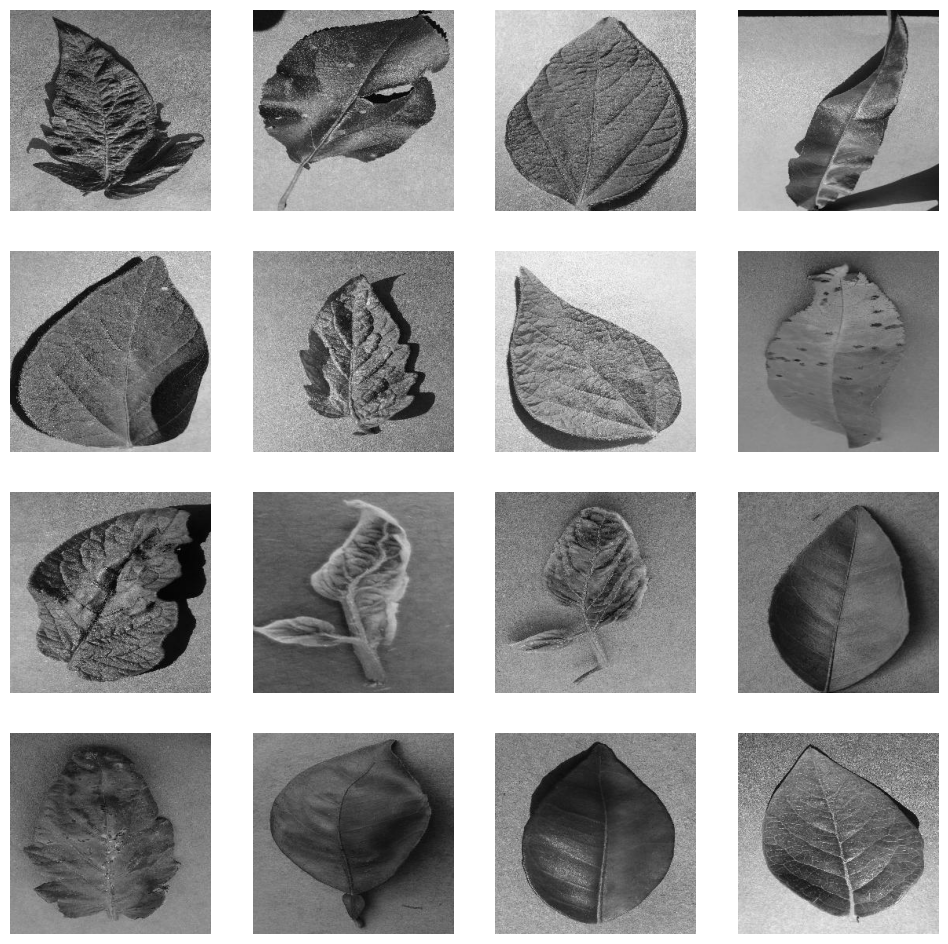

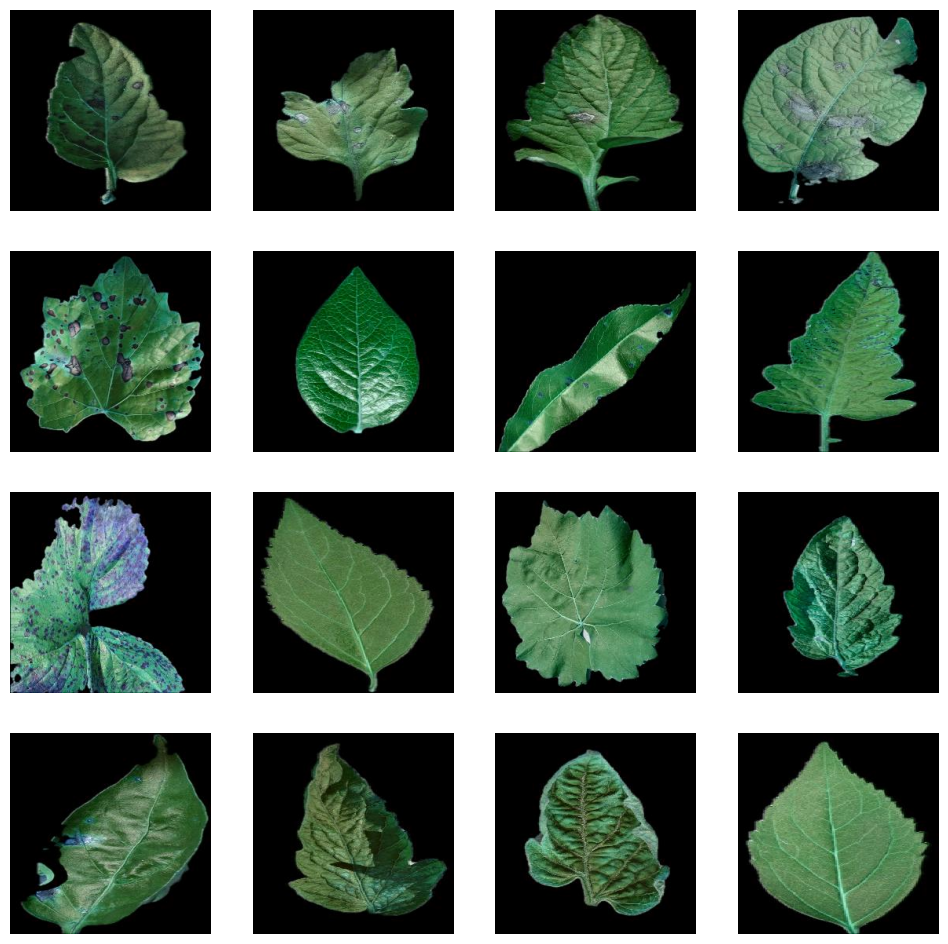

In [8]:
import os
import random
import numpy as np
from PIL import Image
import supervision as sv

base_dir = '../data/plantvillage/plantvillage dataset'
types = ['color', 'grayscale', 'segmented']
all_files = []

# Collect all files as type/relative_path
for t in types:
    type_dir = os.path.join(base_dir, t)
    for root, dirs, files in os.walk(type_dir):
        for file in files:
            rel_path = os.path.relpath(os.path.join(root, file), type_dir)
            all_files.append(f"{t}/{rel_path}")

print(f"Total files found: {len(all_files)}")

# Show 16 random images for each type in a 4x4 grid
for t in types:
    files_of_type = [f for f in all_files if f.startswith(f"{t}/")]
    sample_files = random.sample(files_of_type, 16)
    images = [np.array(Image.open(os.path.join(base_dir, f))) for f in sample_files]
    sv.plot_images_grid(images, grid_size=(4, 4))

In [14]:
import os

base_dir = '../data/plantvillage/plantvillage dataset'
invalid_files = []

for root, dirs, files in os.walk(base_dir):
    for file in files:
        if not (file.endswith('.jpg') or file.endswith('.JPG')):
            invalid_files.append(os.path.join(root, file))

if invalid_files:
    print("Files not ending with .jpg or .JPG:")
    for f in invalid_files:
        print(f)
else:
    print("All files end with .jpg or .JPG")

Files not ending with .jpg or .JPG:
../data/plantvillage/plantvillage dataset/grayscale/Tomato___Late_blight/d0badc95-d04c-457b-8db8-aa6e198f4bd6___GHLB Leaf 10 Day 6.jpeg
../data/plantvillage/plantvillage dataset/grayscale/Pepper,_bell___healthy/42f083e2-272d-4f83-ad9a-573ee90e50ec___Screen Shot 2015-05-06 at 4.01.13 PM.png
../data/plantvillage/plantvillage dataset/color/Tomato___Late_blight/d0badc95-d04c-457b-8db8-aa6e198f4bd6___GHLB Leaf 10 Day 6.jpeg
../data/plantvillage/plantvillage dataset/color/Pepper,_bell___healthy/42f083e2-272d-4f83-ad9a-573ee90e50ec___Screen Shot 2015-05-06 at 4.01.13 PM.png


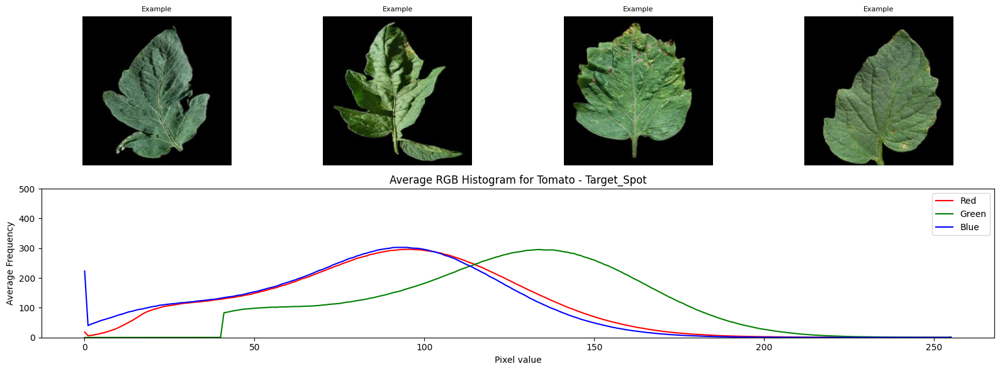

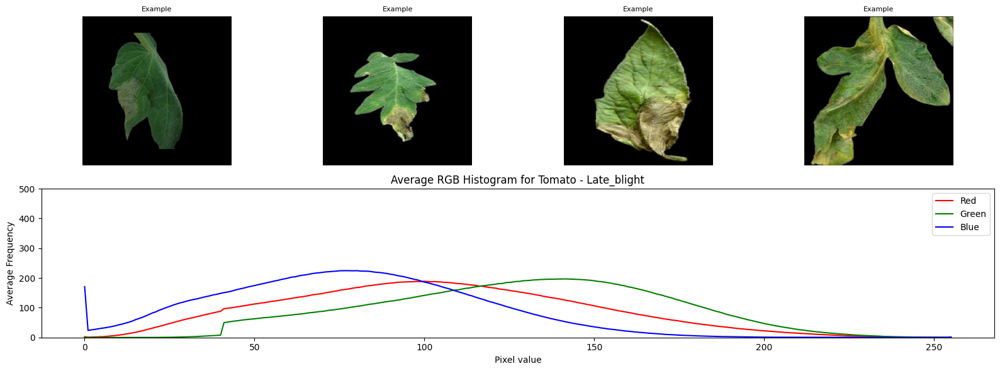

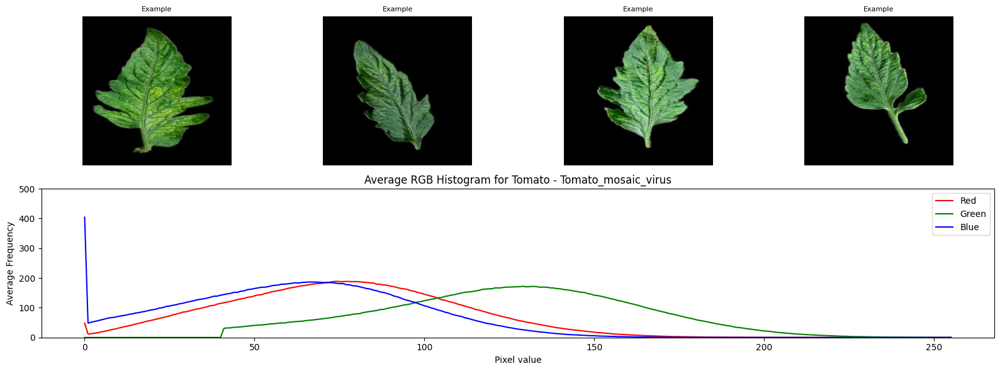

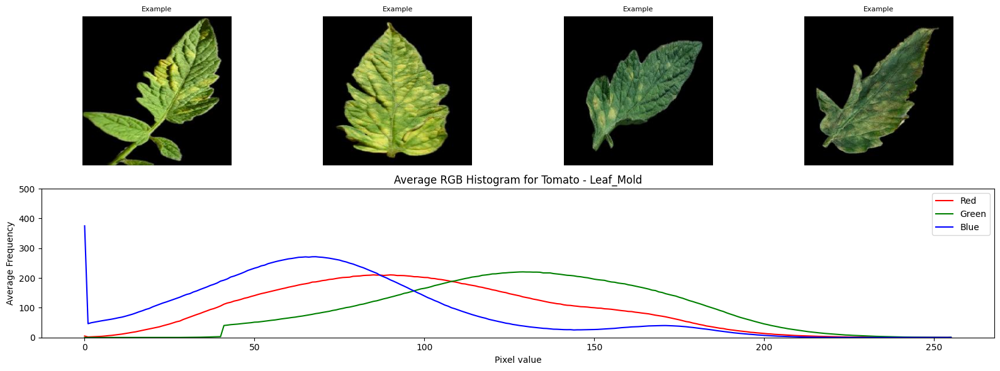

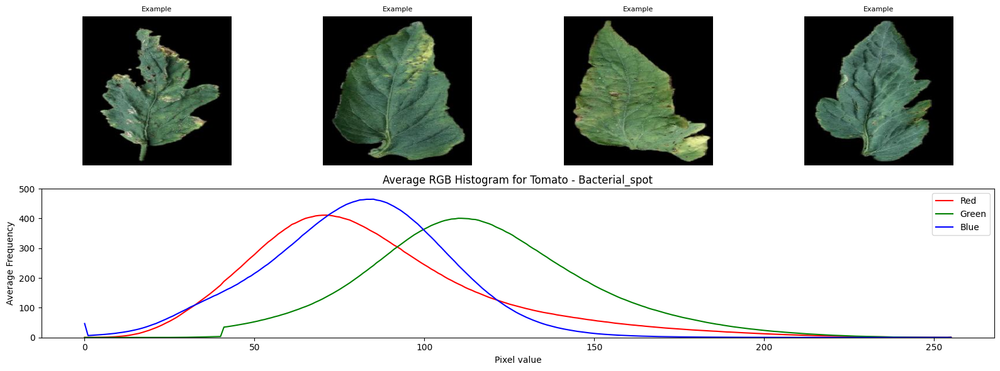

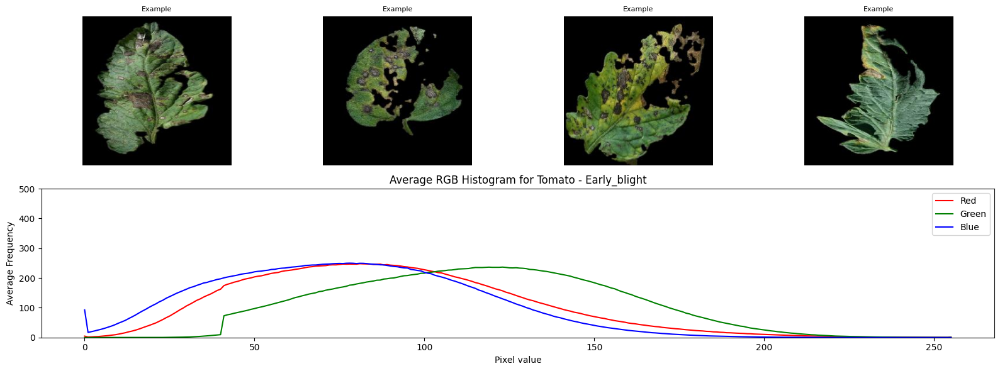

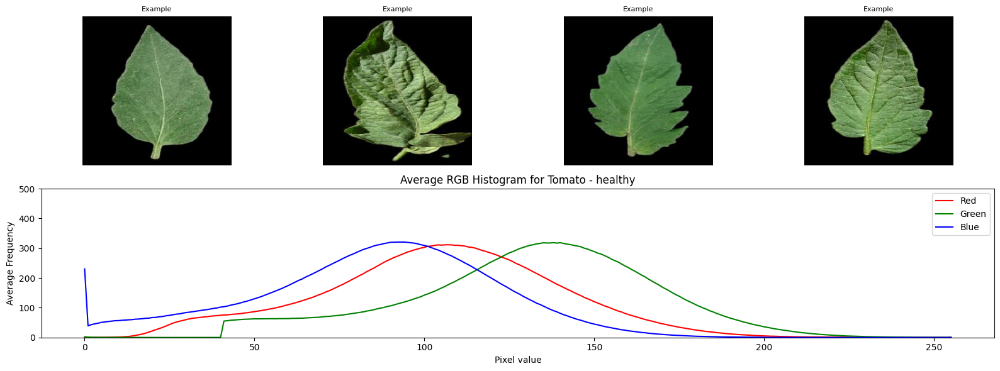

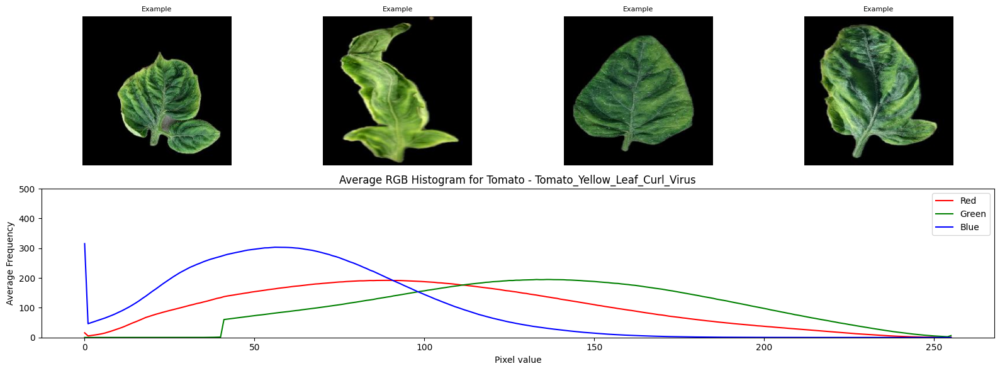

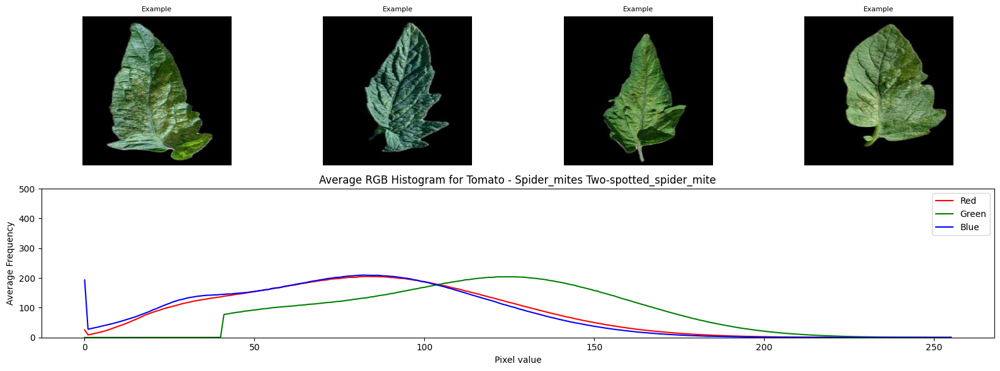

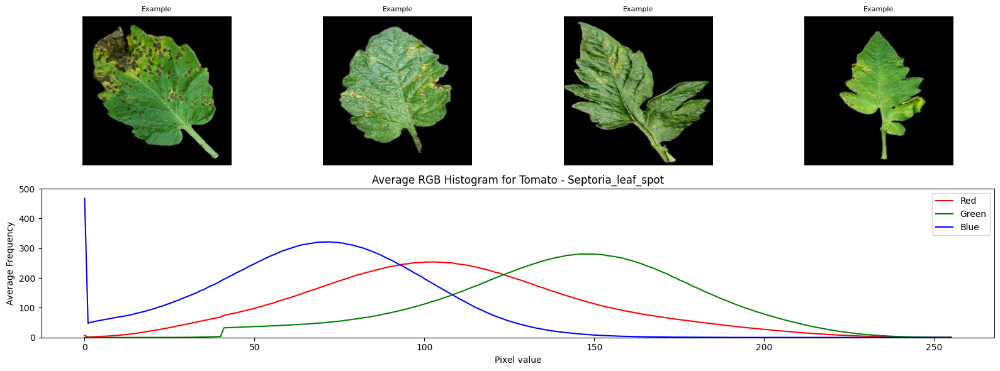

In [18]:
import os
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt
import random

base_dir = '../data/plantvillage/plantvillage dataset/segmented'
tomato_dirs = [d for d in os.listdir(base_dir) if d.startswith('Tomato___')]
disease_to_files = {}

# Group files by disease
for folder in tomato_dirs:
    disease = folder.split('___', 1)[1]
    folder_path = os.path.join(base_dir, folder)
    files = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    disease_to_files[disease] = files

for disease, files in disease_to_files.items():
    n_examples = min(4, len(files))
    example_files = random.sample(files, n_examples)

    # Prepare average histograms
    hist_r = np.zeros(256)
    hist_g = np.zeros(256)
    hist_b = np.zeros(256)
    n_images = 0

    for file in files:
        img_bgr = cv.imread(file)
        img_rgb = cv.cvtColor(img_bgr, cv.COLOR_BGR2RGB)
        # Mask for non-black pixels
        threshold = 40
        mask = np.any(img_rgb > threshold, axis=-1)
        for i, hist in enumerate([hist_r, hist_g, hist_b]):
            channel = img_rgb[..., i][mask]
            h, _ = np.histogram(channel, bins=256, range=(0, 256))
            hist += h
        n_images += 1

    hist_r /= n_images
    hist_g /= n_images
    hist_b /= n_images

    # Plot images and histogram
    plt.figure(figsize=(4 * n_examples, 6))

    # Show example images (no file name in title)
    for idx, file in enumerate(example_files):
        img_bgr = cv.imread(file)
        img_rgb = cv.cvtColor(img_bgr, cv.COLOR_BGR2RGB)
        plt.subplot(2, n_examples, idx + 1)
        plt.imshow(img_rgb)
        plt.axis('off')
        plt.title('Example', fontsize=8)

    # Show average histogram
    plt.subplot(2, 1, 2)
    plt.plot(hist_r, color='r', label='Red')
    plt.plot(hist_g, color='g', label='Green')
    plt.plot(hist_b, color='b', label='Blue')
    plt.title(f'Average RGB Histogram for Tomato - {disease}')
    plt.xlabel('Pixel value')
    plt.ylabel('Average Frequency')
    plt.ylim(0, 500)
    plt.legend()
    plt.tight_layout()
    plt.show()

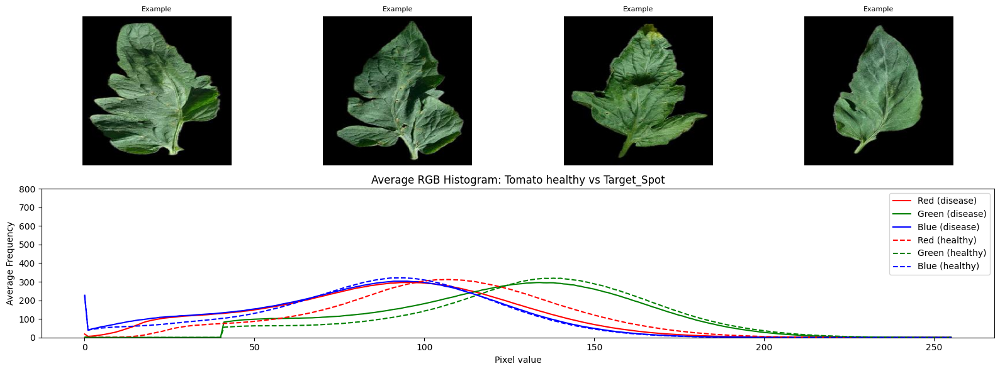

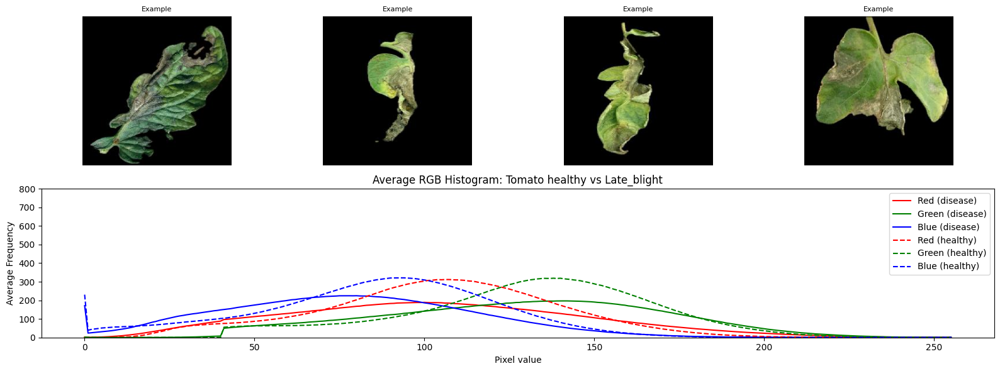

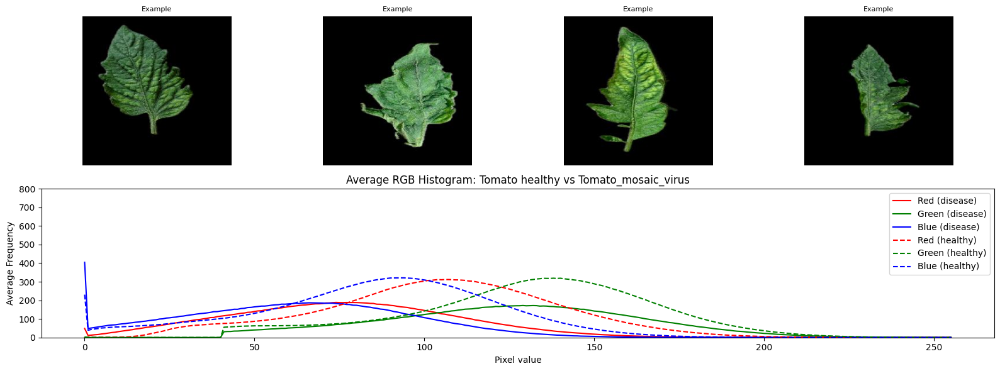

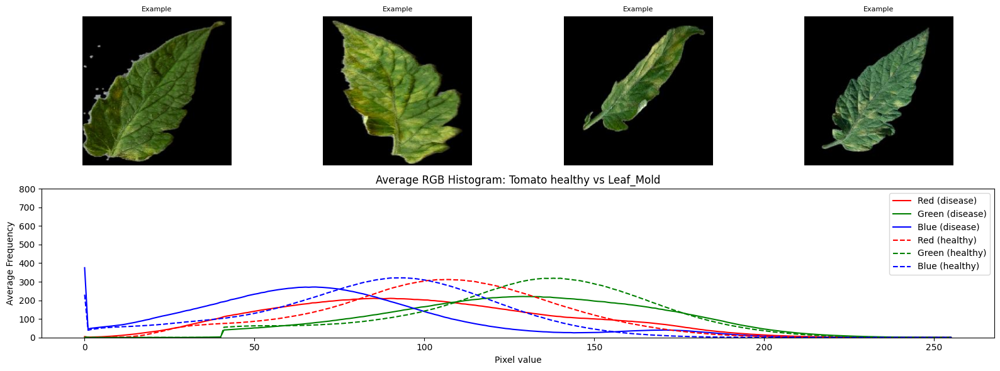

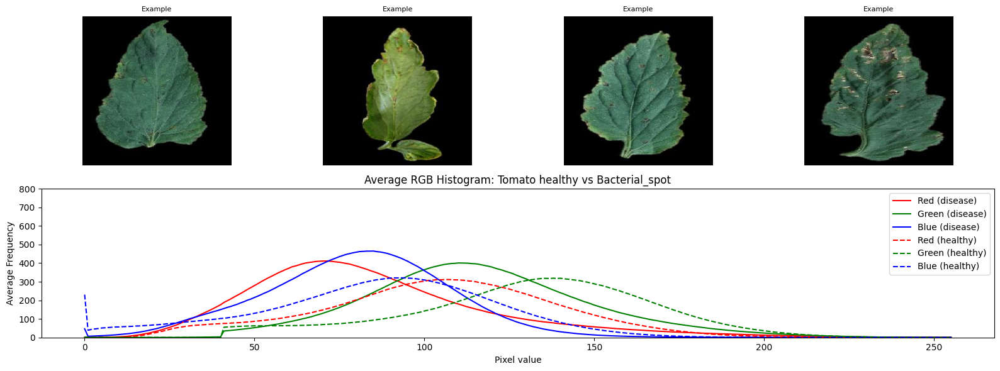

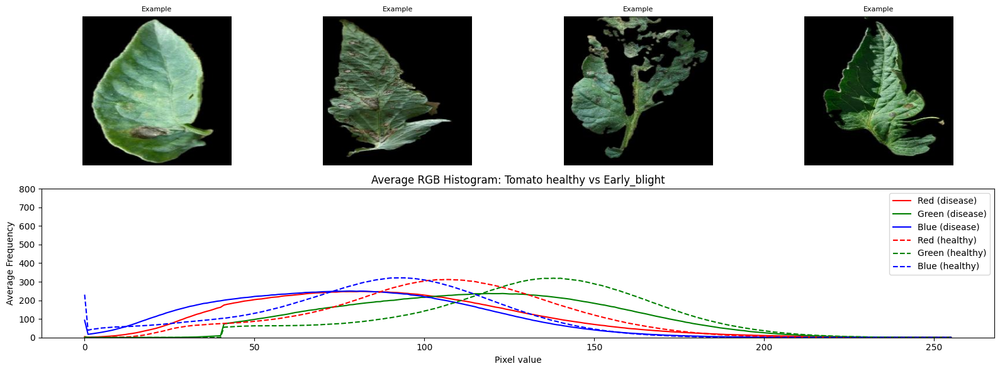

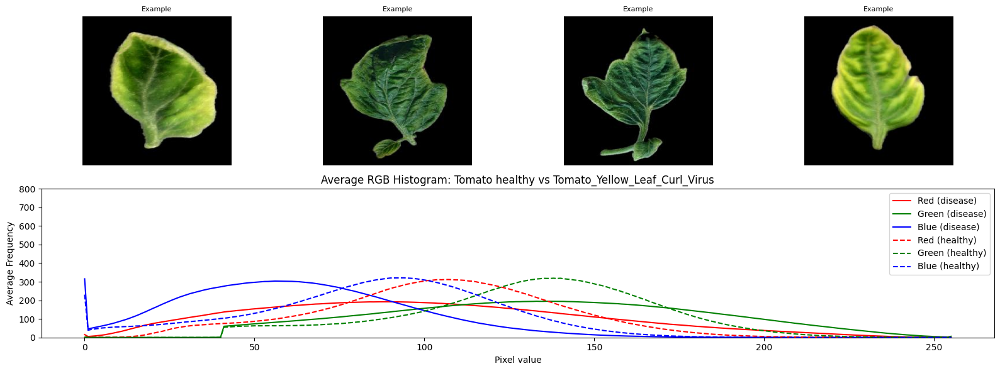

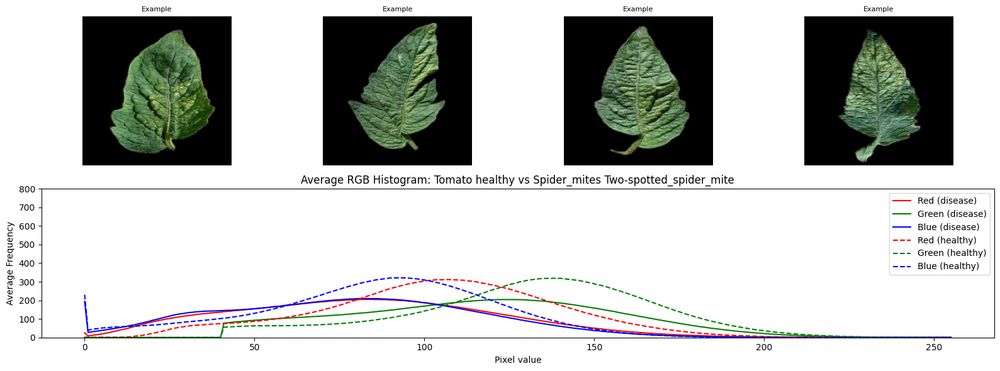

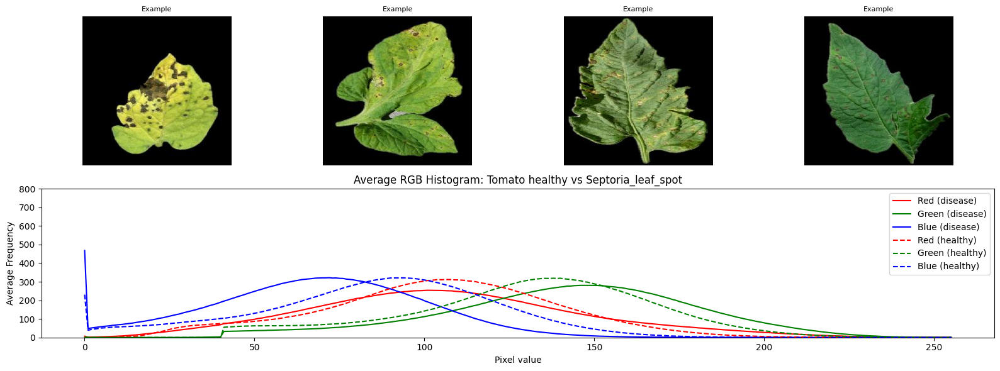

In [20]:
import os
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt
import random

base_dir = '../data/plantvillage/plantvillage dataset/segmented'
tomato_dirs = [d for d in os.listdir(base_dir) if d.startswith('Tomato___')]
disease_to_files = {}

# Group files by disease
for folder in tomato_dirs:
    disease = folder.split('___', 1)[1]
    folder_path = os.path.join(base_dir, folder)
    files = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    disease_to_files[disease] = files

# Compute healthy histogram
healthy_files = disease_to_files.get('healthy', [])
hist_r_h = np.zeros(256)
hist_g_h = np.zeros(256)
hist_b_h = np.zeros(256)
n_images_h = 0

for file in healthy_files:
    img_bgr = cv.imread(file)
    img_rgb = cv.cvtColor(img_bgr, cv.COLOR_BGR2RGB)
    threshold = 40
    mask = np.any(img_rgb > threshold, axis=-1)
    for i, hist in enumerate([hist_r_h, hist_g_h, hist_b_h]):
        channel = img_rgb[..., i][mask]
        h, _ = np.histogram(channel, bins=256, range=(0, 256))
        hist += h
    n_images_h += 1

if n_images_h > 0:
    hist_r_h /= n_images_h
    hist_g_h /= n_images_h
    hist_b_h /= n_images_h

# Plot for each disease
for disease, files in disease_to_files.items():
    if disease == 'healthy':
        continue

    n_examples = min(4, len(files))
    example_files = random.sample(files, n_examples)

    hist_r = np.zeros(256)
    hist_g = np.zeros(256)
    hist_b = np.zeros(256)
    n_images = 0

    for file in files:
        img_bgr = cv.imread(file)
        img_rgb = cv.cvtColor(img_bgr, cv.COLOR_BGR2RGB)
        threshold = 40
        mask = np.any(img_rgb > threshold, axis=-1)
        for i, hist in enumerate([hist_r, hist_g, hist_b]):
            channel = img_rgb[..., i][mask]
            h, _ = np.histogram(channel, bins=256, range=(0, 256))
            hist += h
        n_images += 1

    if n_images > 0:
        hist_r /= n_images
        hist_g /= n_images
        hist_b /= n_images

    plt.figure(figsize=(4 * n_examples, 6))

    # Show example images
    for idx, file in enumerate(example_files):
        img_bgr = cv.imread(file)
        img_rgb = cv.cvtColor(img_bgr, cv.COLOR_BGR2RGB)
        plt.subplot(2, n_examples, idx + 1)
        plt.imshow(img_rgb)
        plt.axis('off')
        plt.title('Example', fontsize=8)

    # Show average histogram (disease vs healthy)
    plt.subplot(2, 1, 2)
    plt.plot(hist_r, color='r', label='Red (disease)')
    plt.plot(hist_g, color='g', label='Green (disease)')
    plt.plot(hist_b, color='b', label='Blue (disease)')
    if n_images_h > 0:
        plt.plot(hist_r_h, color='r', linestyle='--', label='Red (healthy)')
        plt.plot(hist_g_h, color='g', linestyle='--', label='Green (healthy)')
        plt.plot(hist_b_h, color='b', linestyle='--', label='Blue (healthy)')
    plt.title(f'Average RGB Histogram: Tomato healthy vs {disease}')
    plt.xlabel('Pixel value')
    plt.ylabel('Average Frequency')
    plt.ylim(0, 800)
    plt.legend()
    plt.tight_layout()
    plt.show()

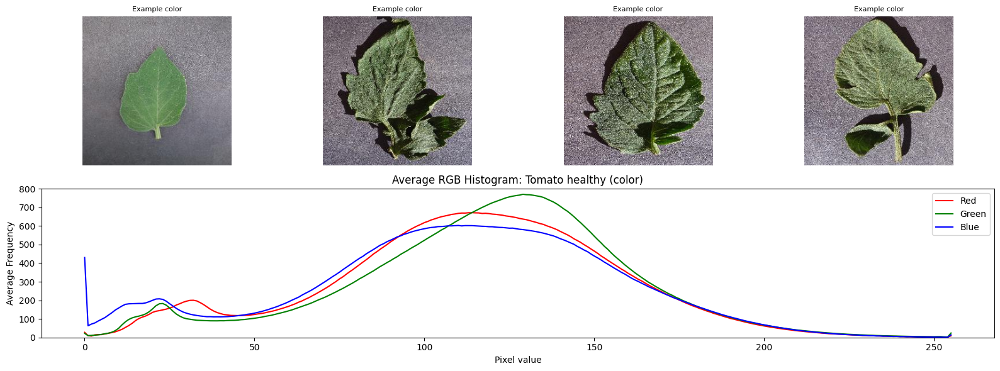

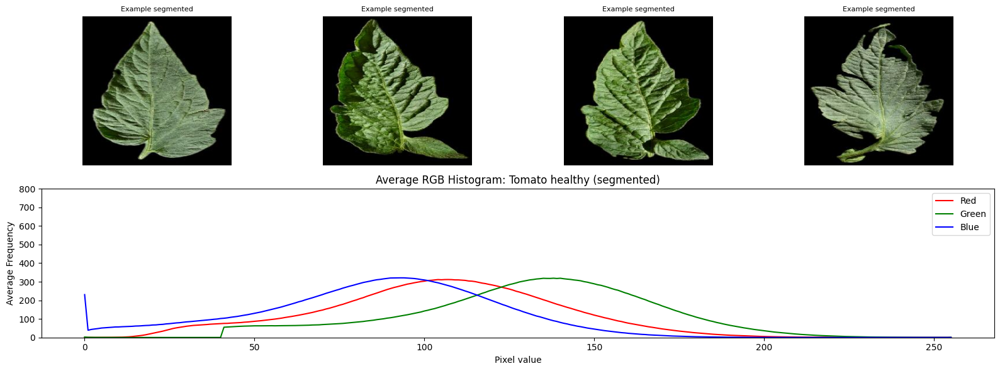

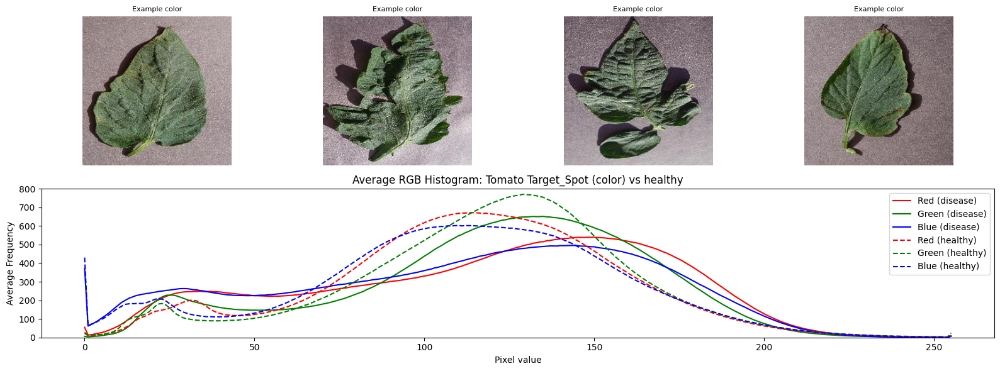

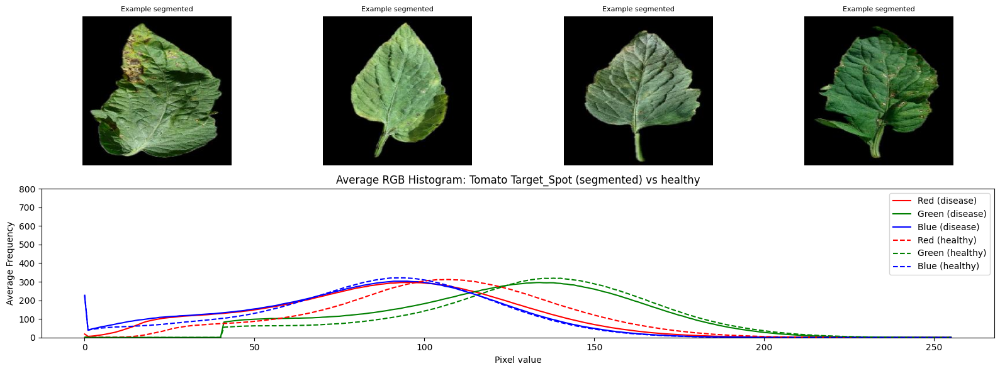

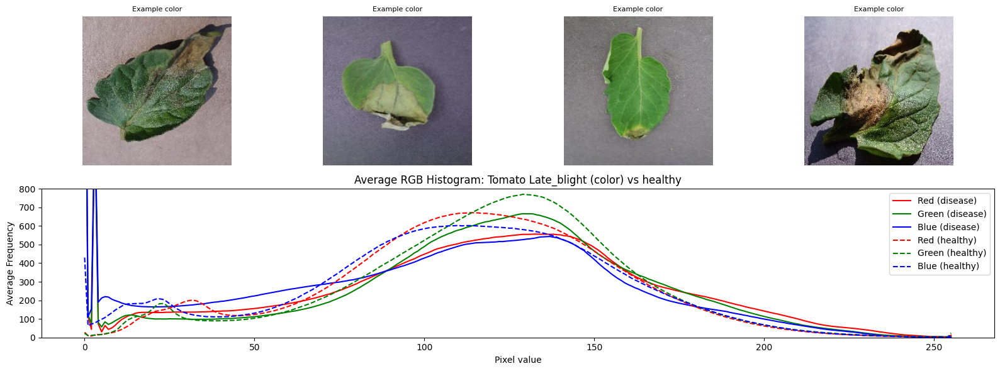

...

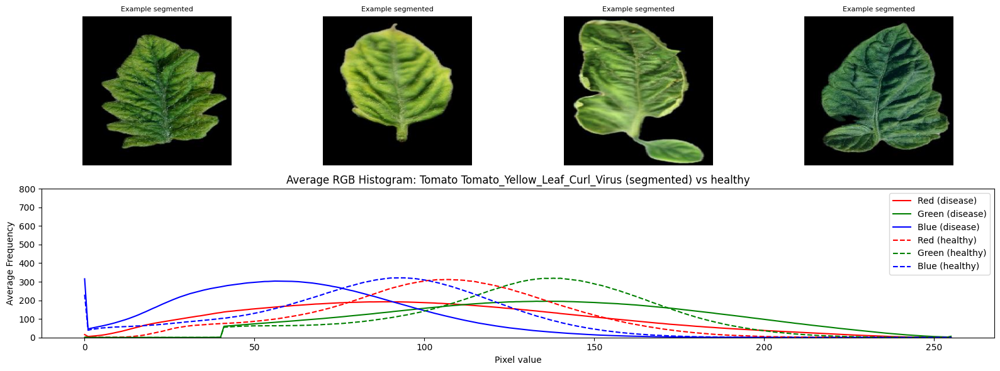

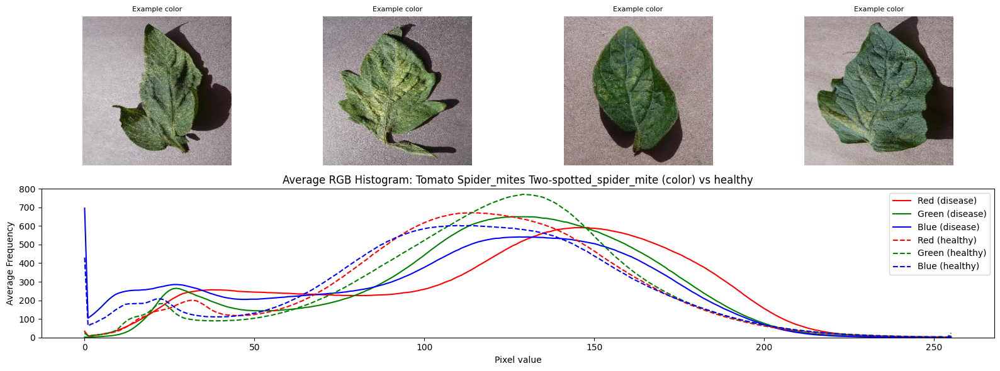

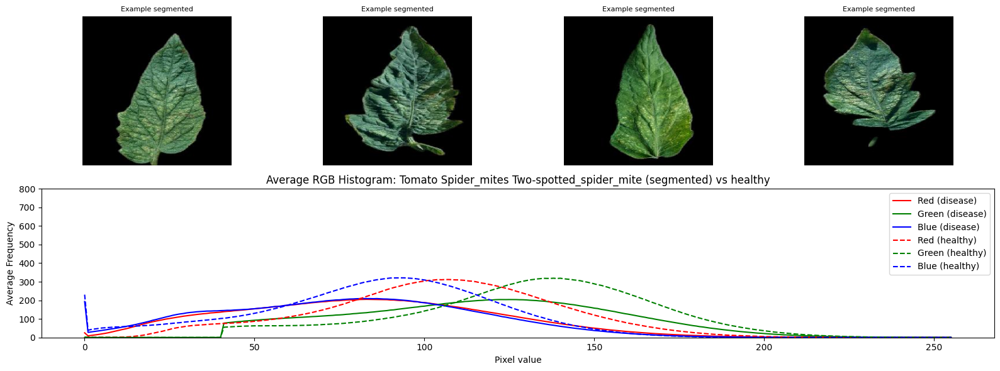

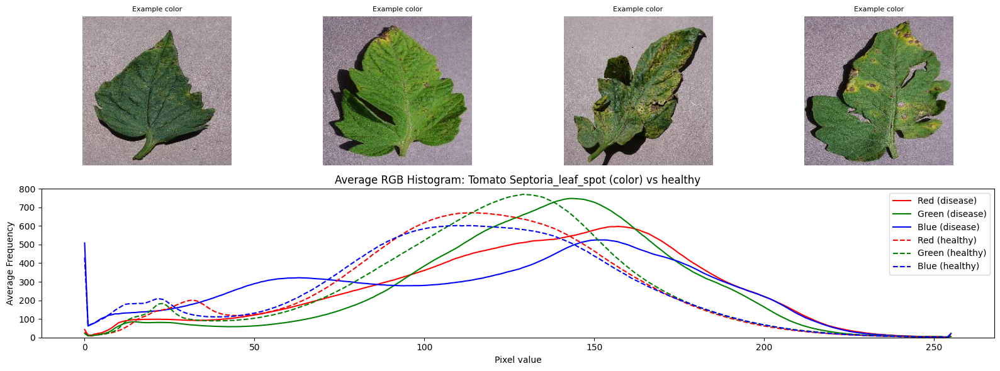

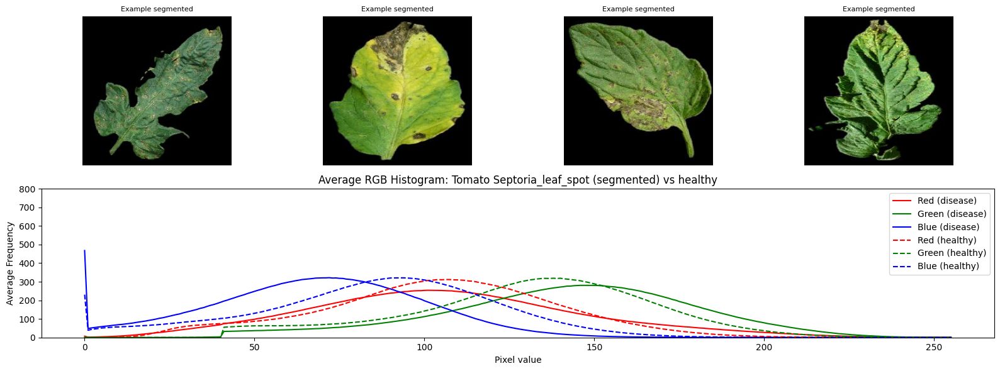

In [21]:
import os
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt
import random

base_dir = '../data/plantvillage/plantvillage dataset'
types = ['color', 'segmented']

def get_files_by_disease(type_dir, prefix='Tomato___'):
    dirs = [d for d in os.listdir(type_dir) if d.startswith(prefix)]
    disease_to_files = {}
    for folder in dirs:
        disease = folder.split('___', 1)[1]
        folder_path = os.path.join(type_dir, folder)
        files = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
        disease_to_files[disease] = files
    return disease_to_files

# Get files for both color and segmented
disease_to_files = {t: get_files_by_disease(os.path.join(base_dir, t)) for t in types}

# --- 1. Show healthy histograms and examples for color and segmented ---
healthy_hist = {}
healthy_examples = {}

for t in types:
    files = disease_to_files[t].get('healthy', [])
    n_examples = min(4, len(files))
    example_files = random.sample(files, n_examples)
    healthy_examples[t] = example_files

    hist_r = np.zeros(256)
    hist_g = np.zeros(256)
    hist_b = np.zeros(256)
    n_images = 0

    for file in files:
        img_bgr = cv.imread(file)
        img_rgb = cv.cvtColor(img_bgr, cv.COLOR_BGR2RGB)
        if t == 'segmented':
            threshold = 40
            mask = np.any(img_rgb > threshold, axis=-1)
        else:
            mask = np.ones(img_rgb.shape[:2], dtype=bool)
        for i, hist in enumerate([hist_r, hist_g, hist_b]):
            channel = img_rgb[..., i][mask]
            h, _ = np.histogram(channel, bins=256, range=(0, 256))
            hist += h
        n_images += 1

    if n_images > 0:
        hist_r /= n_images
        hist_g /= n_images
        hist_b /= n_images

    healthy_hist[t] = (hist_r, hist_g, hist_b)

    # Plot examples and histogram
    plt.figure(figsize=(16, 6))
    for idx, file in enumerate(example_files):
        img_bgr = cv.imread(file)
        img_rgb = cv.cvtColor(img_bgr, cv.COLOR_BGR2RGB)
        plt.subplot(2, 4, idx + 1)
        plt.imshow(img_rgb)
        plt.axis('off')
        plt.title(f'Example {t}', fontsize=8)
    plt.subplot(2, 1, 2)
    plt.plot(hist_r, color='r', label='Red')
    plt.plot(hist_g, color='g', label='Green')
    plt.plot(hist_b, color='b', label='Blue')
    plt.title(f'Average RGB Histogram: Tomato healthy ({t})')
    plt.xlabel('Pixel value')
    plt.ylabel('Average Frequency')
    plt.ylim(0, 800)
    plt.legend()
    plt.tight_layout()
    plt.show()

# --- 2. For each disease, show color and segmented histograms with healthy as dashed, and 4 example images each ---
for disease in disease_to_files['color']:
    if disease == 'healthy':
        continue
    for t in types:
        files = disease_to_files[t].get(disease, [])
        n_examples = min(4, len(files))
        example_files = random.sample(files, n_examples)

        hist_r = np.zeros(256)
        hist_g = np.zeros(256)
        hist_b = np.zeros(256)
        n_images = 0

        for file in files:
            img_bgr = cv.imread(file)
            img_rgb = cv.cvtColor(img_bgr, cv.COLOR_BGR2RGB)
            if t == 'segmented':
                threshold = 40
                mask = np.any(img_rgb > threshold, axis=-1)
            else:
                mask = np.ones(img_rgb.shape[:2], dtype=bool)
            for i, hist in enumerate([hist_r, hist_g, hist_b]):
                channel = img_rgb[..., i][mask]
                h, _ = np.histogram(channel, bins=256, range=(0, 256))
                hist += h
            n_images += 1

        if n_images > 0:
            hist_r /= n_images
            hist_g /= n_images
            hist_b /= n_images

        # Plot examples and histogram
        plt.figure(figsize=(16, 6))
        for idx, file in enumerate(example_files):
            img_bgr = cv.imread(file)
            img_rgb = cv.cvtColor(img_bgr, cv.COLOR_BGR2RGB)
            plt.subplot(2, 4, idx + 1)
            plt.imshow(img_rgb)
            plt.axis('off')
            plt.title(f'Example {t}', fontsize=8)
        plt.subplot(2, 1, 2)
        plt.plot(hist_r, color='r', label='Red (disease)')
        plt.plot(hist_g, color='g', label='Green (disease)')
        plt.plot(hist_b, color='b', label='Blue (disease)')
        # Add healthy as dashed
        hr, hg, hb = healthy_hist[t]
        plt.plot(hr, color='r', linestyle='--', label='Red (healthy)')
        plt.plot(hg, color='g', linestyle='--', label='Green (healthy)')
        plt.plot(hb, color='b', linestyle='--', label='Blue (healthy)')
        plt.title(f'Average RGB Histogram: Tomato {disease} ({t}) vs healthy')
        plt.xlabel('Pixel value')
        plt.ylabel('Average Frequency')
        plt.ylim(0, 800)
        plt.legend()
        plt.tight_layout()
        plt.show()

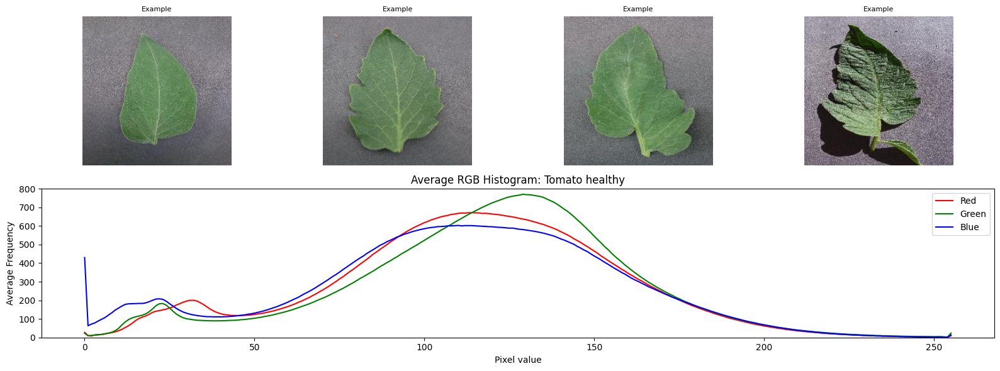

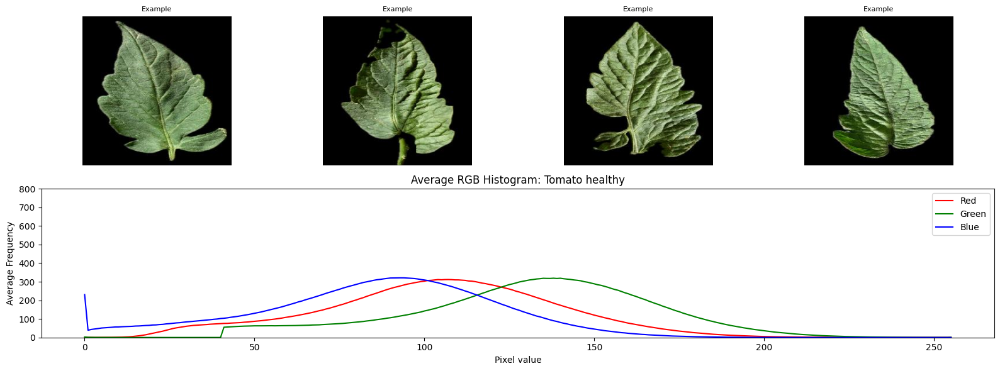

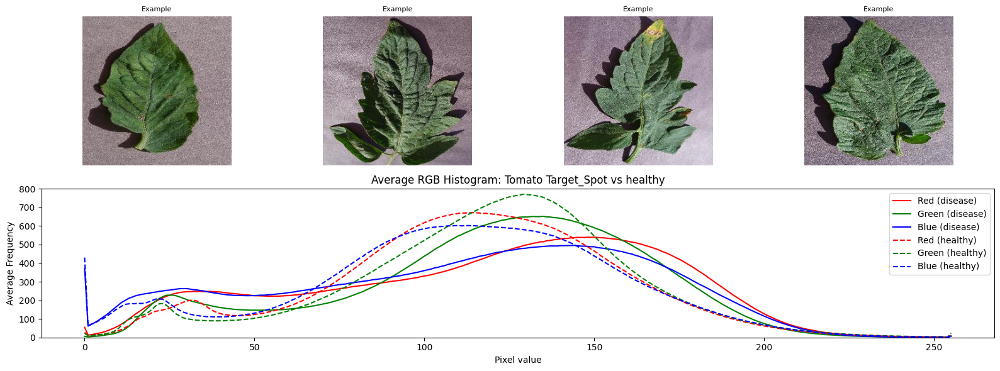

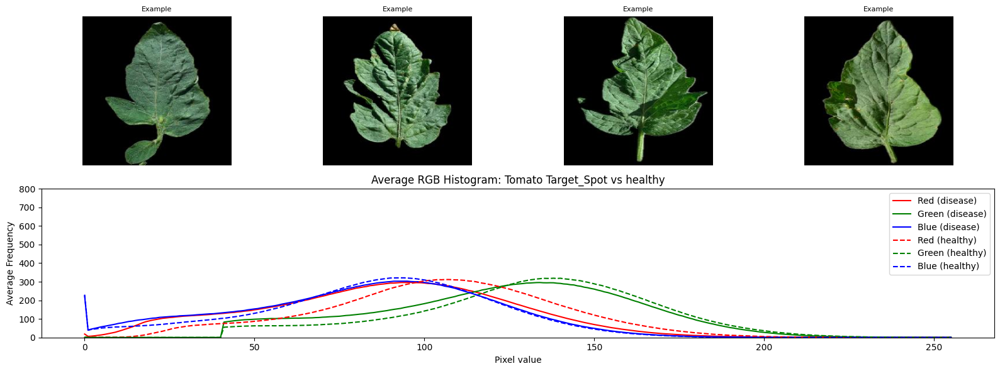

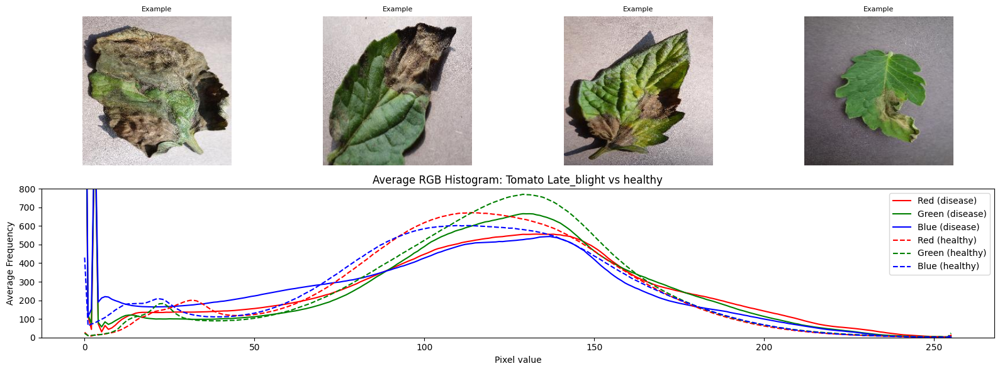

...

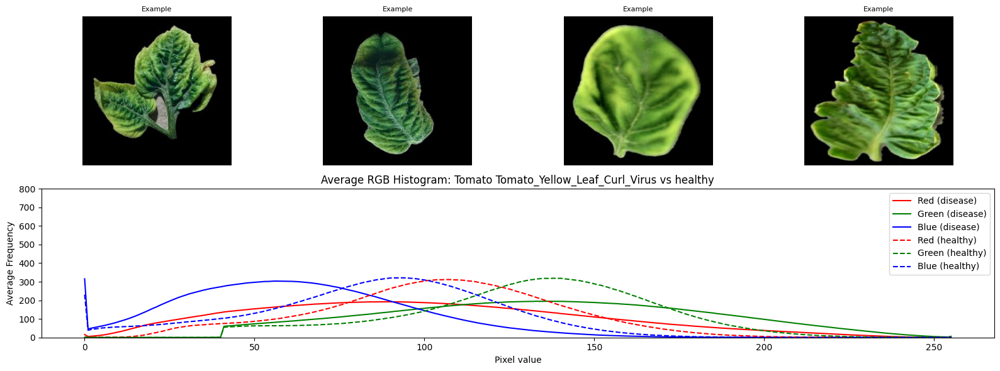

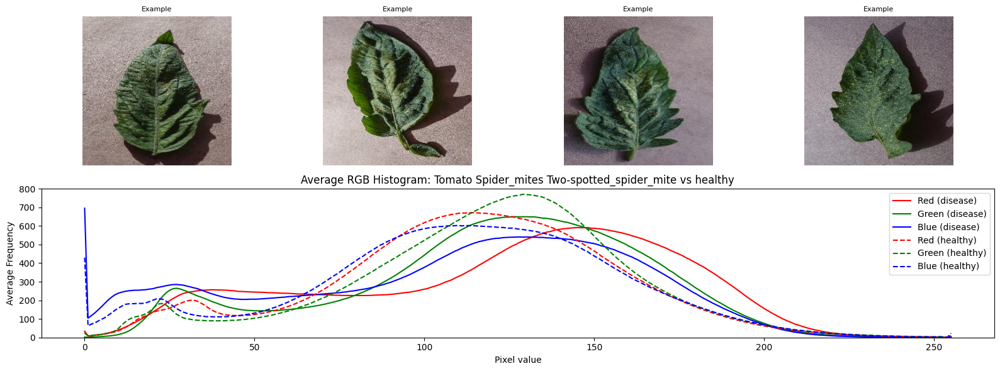

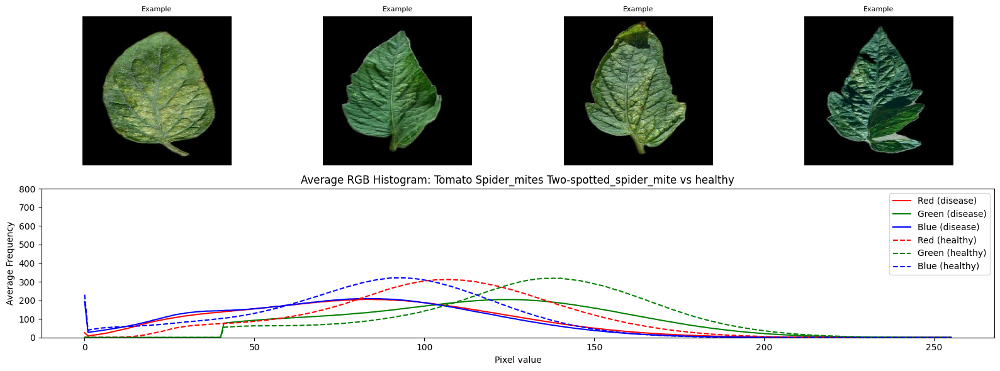

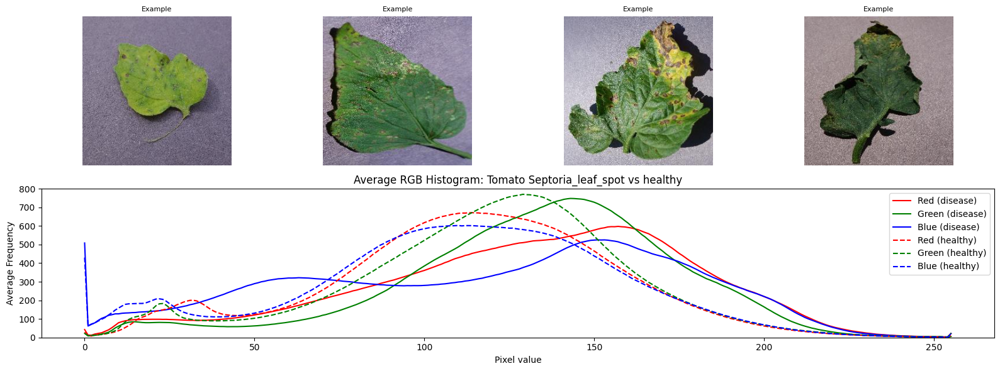

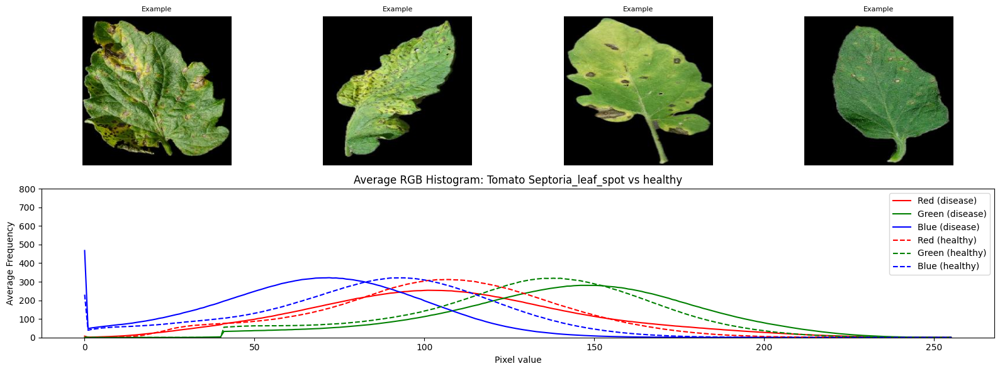

In [2]:
import src.utils as utils

utils.print_histograms()